## Video Embedding Pipeline

1. Run cell 1 to clone the Github repo and move files to current directory
4. Add youtube videos to json in video2dataset.py (example json is below) OR upload a parquet file with url and caption columns to the current session + remove None arguement in video2dataset.py.
4. Run cell 2
6. Outputs should populate into the created file directories
Source repo: https://github.com/joelwk/content-unaware-segmentation

Example json as seen in video2dataset.py. The 5 youtube videos are processed in the demo below.

            dataset_requirements = {
                "data": [
                    {"url": "www.youtube.com/watch?v=nXBoOam5xJs", "caption": "The Deadly Portuguese Man O' War"},
                    {"url": "www.youtube.com/watch?v=yZ57m4uqFtI", "caption": "Baby 5 Color Eggs Song!"},
                    {"url": "www.youtube.com/watch?v=ND92YNQv0TU", "caption": "Macaque Monkeys at War"},
                    {"url": "www.youtube.com/watch?v=-tvA3Ezqjl8", "caption": "Top 5 David Attenborough Moments"},
                    {"url": "www.youtube.com/watch?v=oP2oGREukAE", "caption": "BBC Earth 50 Top Natural History Moments"},
                ]
            }

In [ ]:
# Clone the GitHub repository
!git clone https://github.com/joelwk/content-unaware-segmentation.git
import shutil
import os

source_folder = 'content-unaware-segmentation/pipeline' # Copy all files from the 'pipeline' folder
destination_folder = '.' # to the current directory
os.makedirs(destination_folder, exist_ok=True)
for filename in os.listdir(source_folder):
    filepath = os.path.join(source_folder, filename)
    if os.path.isfile(filepath):
        shutil.copy(filepath, destination_folder)

specific_files = {
    'scripts': ['fold_seams.py', 'successor_segmentation.py'], # and select files from scripts
    'processing': ['segment_processing.py', 'load_data.py']# and processing
}

for folder, files in specific_files.items():
    source_folder = f'content-unaware-segmentation/{folder}'
    for filename in files:
        source_path = os.path.join(source_folder, filename)
        destination_path = os.path.join(destination_folder, filename)
        if os.path.exists(source_path):
            shutil.copy(source_path, destination_path)
        else:
            print(f"File does not exist: {source_path}")

Cloning into 'content-unaware-segmentation'...
remote: Enumerating objects: 327, done.
remote: Counting objects: 100% (13/13), done.
remote: Compressing objects: 100% (13/13), done.
remote: Total 327 (delta 0), reused 6 (delta 0), pack-reused 314
Receiving objects: 100% (327/327), 450.78 MiB | 27.34 MiB/s, done.
Resolving deltas: 100% (71/71), done.
Updating files: 100% (170/170), done.


Reading URLs from: ./datasets/dataset_requirements.parquet
Processing video 1: www.youtube.com/watch?v=nXBoOam5xJs
Return code: 0
STDOUT: Starting the downloading of this file
Sharding file number 1 of 1 called /content/datasets/dataset_requirements.parquet

[download]   0.0% of    3.69MiB at   91.41KiB/s ETA 00:41
[download]   0.1% of    3.69MiB at  259.81KiB/s ETA 00:14
[download]   0.2% of    3.69MiB at  404.13KiB/s ETA 00:09
[download]   0.4% of    3.69MiB at  833.52KiB/s ETA 00:04
[download]   0.8% of    3.69MiB at    1.64MiB/s ETA 00:02
[download]   1.7% of    3.69MiB at    1.37MiB/s ETA 00:02
[download]   3.4% of    3.69MiB at    1.43MiB/s ETA 00:02
[download]   6.7% of    3.69MiB at  690.87KiB/s ETA 00:05
[download]  13.5% of    3.69MiB at  788.59KiB/s ETA 00:04
[download]   0.0% of   36.34MiB at   23.51KiB/s ETA 26:23
[download]   0.0% of   36.34MiB at   69.67KiB/s ETA 08:54
[download]   0.0% of   36.34MiB at  144.09KiB/s ETA 04:18
[download]   0.0% of   18.15MiB at   28.28KiB

Streaming output truncated to the last 5000 lines.
       -1.2671e-01, -6.1035e-01, -5.9021e-02, -4.3677e-01, -9.5093e-02,
        1.1169e-01,  6.2805e-02, -2.3169e-01, -1.3770e-01, -8.8013e-02,
       -4.2578e-01, -6.0303e-01,  2.2839e-01, -2.9663e-02,  3.6890e-01,
        1.1953e+00,  1.1348e+00,  4.6680e-01, -4.7363e-01,  1.0645e-01,
        7.1875e-01, -3.7262e-02,  1.0254e-01,  1.9482e-01,  4.8438e-01,
        2.2766e-01,  8.7402e-01,  6.1737e-02,  1.7163e-01, -2.4023e-01,
        8.2092e-02, -1.4282e-01,  2.0728e-01, -5.1849e-02, -1.9702e-01,
       -3.8257e-01, -1.7529e-01, -1.1743e-01,  3.6987e-01,  2.4939e-01,
        1.6907e-01, -5.8167e-02, -5.2643e-02, -3.2349e-02,  5.0171e-02,
        3.2031e-01,  2.9517e-01, -8.0371e-01, -1.8872e-01,  1.9861e-01,
       -1.1121e-01,  4.8828e-02,  1.7090e-02,  6.2561e-04, -1.3867e-01,
        1.9760e-02,  6.1951e-02, -5.2490e-02, -1.1224e-01, -3.4375e-01,
        2.7979e-01, -3.7048e-02,  2.9883e-01, -9.3262e-01,  2.0020e-01,
       -2.443

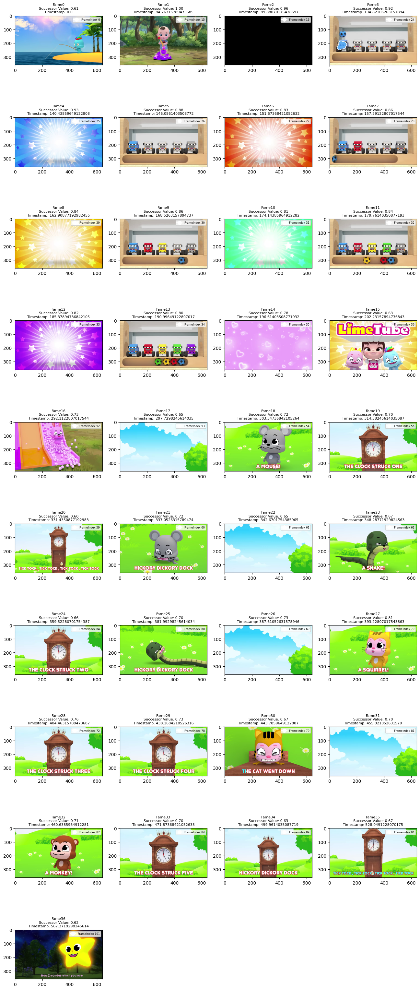

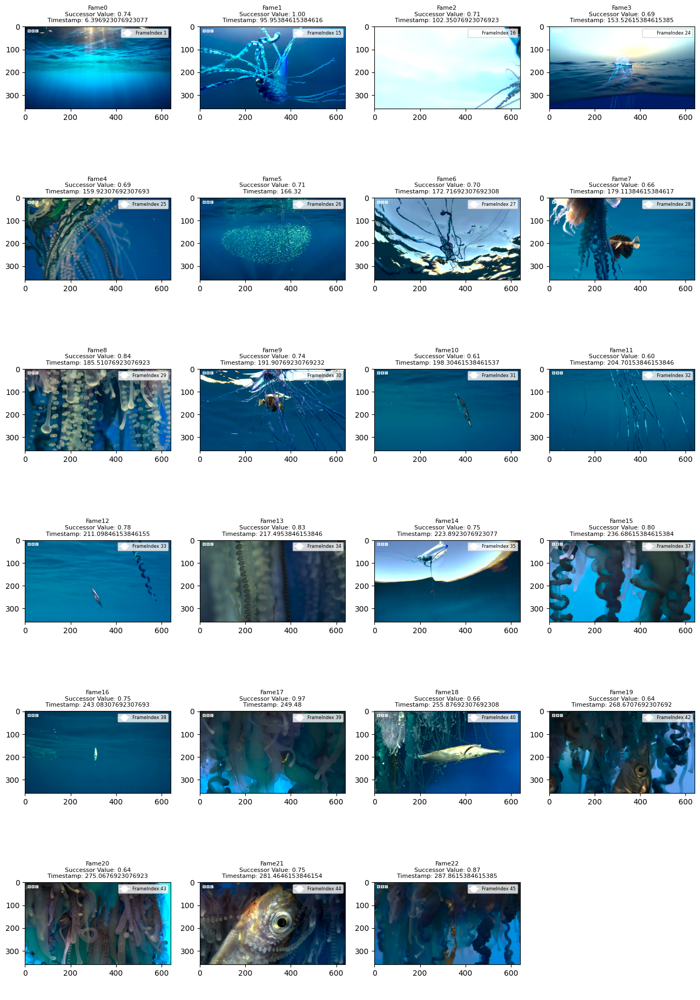

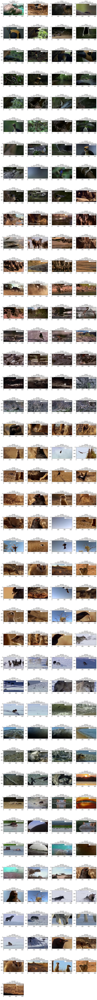

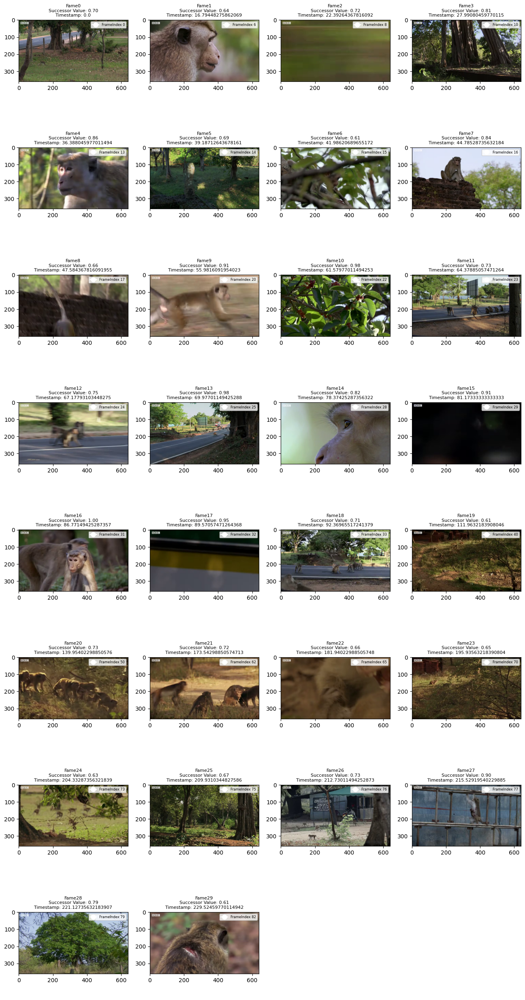

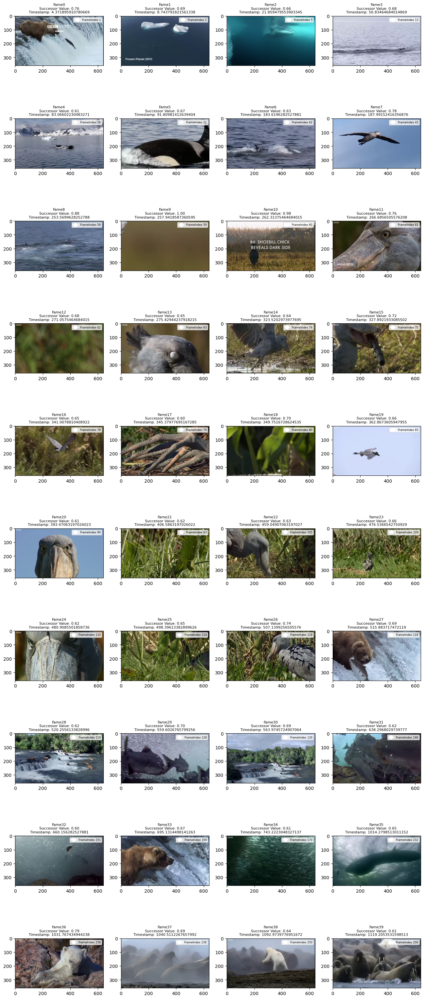

In [ ]:
# Install pipeline requirements and create required directories
%run pipeline.py
# Create video dataset
%run video2dataset.py
# Create embeddings
%run clipvideoencode.py
# Rename and move files for segmentation
%run rename_and_move_files.py

# Sucessor segmentation process
from successor_segmentation import SegmentSuccessorAnalyzer, run_analysis
from fold_seams import main
'''
# To analyze just video 1: specific_videos=[1]
Example:
run_analysis(SegmentSuccessorAnalyzer, specific_videos=[1])
main(specific_videos=[1])

# To analyze multiple videos: specific_videos=[1,2,3]
Example:
run_analysis(SegmentSuccessorAnalyzer, specific_videos=[1,2,3])
main(specific_videos=[1,2,3])

# To analyze all videos: remove specific_videos argument
Example:
run_analysis(SegmentSuccessorAnalyzer)
main()
'''
run_analysis(SegmentSuccessorAnalyzer)
main()
# Get the avergae embedding value for each segment
%run segment_averaging.py
# Get meta data, consolidate files and organize files into individual directories
%run move_and_group.py